## Notebook for the SCVI and stem cells gene enrichment analysis

### Developed by: Anna Maguza

### Institute of Computational Biology - Computational Health Centre - Hemlholtz Munich

### 2 December 2022

#### Load required packages

In [4]:
import scanpy as sc
import numpy as np
import pandas as pd
#import scvi
import anndata as ad
import seaborn as sns
import numpy as np
#from scvi.model.utils import mde
#import pymde


#### Setup Cells


In [ ]:
%matplotlib inline

In [ ]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.9.3 pandas==1.5.1 scikit-learn==1.1.3 statsmodels==0.13.5 pynndescent==0.5.8


#### Upload Data

In [4]:
input_Normal_file = '/lustre/groups/talaveralopez/datasets/Colorectal_cancer/Raw_data/Normal Control Gut Cell Atlas/Full_obj_raw_counts_nosoupx_v2.h5ad'  # the file that will store the analysis results
output_Normal_file = '/lustre/groups/talaveralopez/workspace/anna.maguza/Processed_datasets/Gut_cell_atlas_three_donors_output.h5ad'  # the file that will store the analysis results

In [56]:
#Anndata upload
control_ad = sc.read_h5ad(input_Normal_file)
control_ad.X

<428469x33538 sparse matrix of type '<class 'numpy.float32'>'
	with 760344941 stored elements in Compressed Sparse Row format>

### Quick Filtering of Gut Cell Atlas file

In [13]:
#Remove Pediatric Crohn Disease
control_ad_clean = control_ad[~control_ad.obs['Diagnosis'].isin(['Pediatric Crohn Disease']),:]
del control_ad
#Deleting the lymph node samples
control_ad_clean = control_ad_clean[~control_ad_clean.obs['Region'].isin(['lymph node']),:]
#Adding percentage of ribosomial genes
control_ad_clean.var['ribo'] = control_ad_clean.var_names.str.startswith(("RPS","RPL"))  # annotate the group of ribosomal genes as 'ribo'
sc.pp.calculate_qc_metrics(control_ad_clean, qc_vars=['ribo'], percent_top=None, log1p=False, inplace=True)
#Filtering by genes
control_ad_clean = control_ad_clean[control_ad_clean.obs.n_genes_by_counts < 5000, :]
control_ad_clean = control_ad_clean[control_ad_clean.obs.n_genes_by_counts > 50, :]
#Filtering by counts
control_ad_clean = control_ad_clean[control_ad_clean.obs.total_counts < 50000, :]


/tmp/ipykernel_92895/2923116805.py:7: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  control_ad_clean.var['ribo'] = control_ad_clean.var_names.str.startswith(("RPS","RPL"))  # annotate the group of ribosomal genes as 'ribo'


### Starting SCVi

In [14]:
#Finding the highly variable genes (the span=1 is added because I faced an error "ValueError: b'There are other near singularities as well. 0.090619\n'")
sc.pp.highly_variable_genes(
    control_ad_clean,
    flavor="seurat_v3",
    n_top_genes=7000,
    batch_key="sample name",
    subset=True,
    span =1
)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/home/icb/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [15]:
#Register the AnnData object with the correct key to identify the sample and the layer key with the count data.
scvi.model.SCVI.setup_anndata(control_ad_clean, batch_key="sample name")

In [16]:
# Correction with SCVI 3 layers and negative binomial gene likelihood
vae_3layers_nb = scvi.model.SCVI(control_ad_clean, n_layers=3, n_latent=50, gene_likelihood="nb")

In [17]:
#train scVI
vae_3layers_nb.train()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 21/21: 100%|██████| 21/21 [13:14<00:00, 34.76s/it, loss=2.44e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=21` reached.


Epoch 21/21: 100%|██████| 21/21 [13:14<00:00, 37.82s/it, loss=2.44e+03, v_num=1]


In [18]:
#evaluate the latent representation of each cell in the dataset and add it to the AnnData object
control_ad_clean.obsm["X_scVI"] = vae_3layers_nb.get_latent_representation()

In [19]:
#cluster the dataset and visualize it the scVI latent space
sc.pp.neighbors(control_ad_clean, use_rep="X_scVI")
sc.tl.umap(control_ad_clean, min_dist = 0.3, spread = 3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:59)


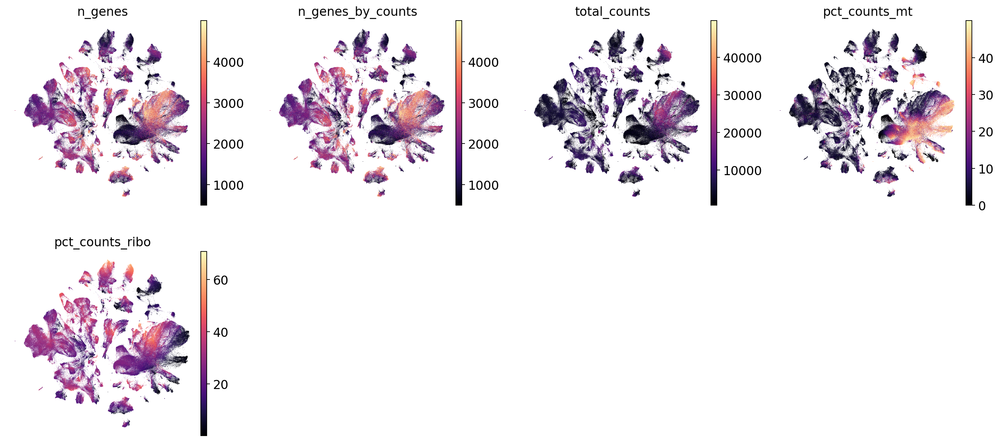

In [20]:
sc.pl.umap(control_ad_clean, color= ['n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo'], color_map = "magma", size = 0.3, frameon = False)

/home/icb/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


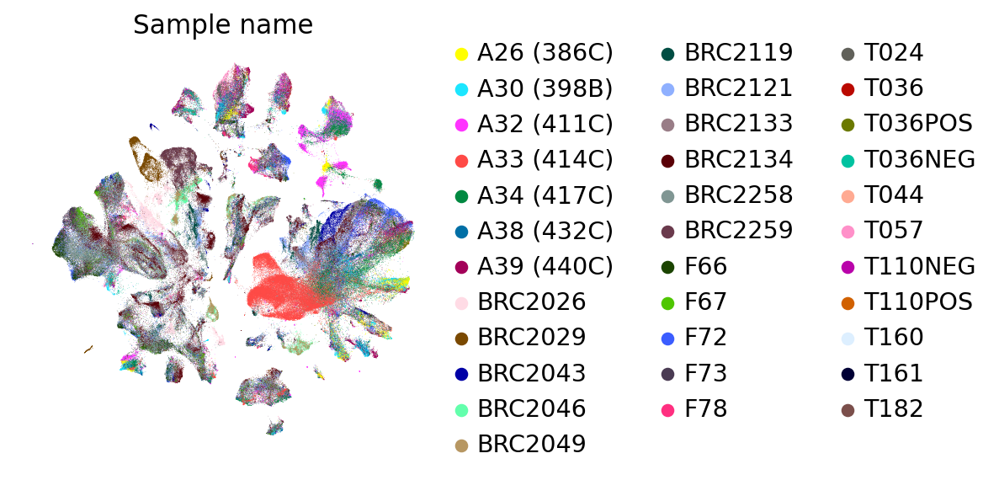

In [22]:
sc.pl.umap(control_ad_clean, color= ['Sample name'], color_map = "magma", size = 0.3, frameon = False)

In [77]:
sc.set_figure_params(figsize=(15, 15),dpi=300)
sc.pl.umap(control_ad_clean, color= ['category'], color_map = "magma", size = 0.3, frameon = False)

/home/icb/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


### Save object

In [24]:
adata_export = ad.AnnData(X = control_ad_clean.X, obs = control_ad_clean.obs, var = control_ad_clean.var, uns = control_ad_clean.uns, obsm = control_ad_clean.obsm, obsp = control_ad_clean.obsp)
adata_export

AnnData object with n_obs × n_vars = 372785 × 7000
    obs: 'Sample name', 'Diagnosis', 'Age', 'sample name', 'Region code', 'Fraction', 'Gender', 'Region', '10X', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_scores', 'predicted_doublets', 'category', 'Age_group', 'Integrated_05', 'total_counts_ribo', 'pct_counts_ribo', '_scvi_batch', '_scvi_labels'
    var: 'gene_ids', 'feature_types', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg', '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'umap', 'sample name_colors', 'Sample name_colors', 'category_colors'
    obsm: 'X_scVI', 'X_umap'
    obsp: 'distances', 'connectivities'

In [25]:
adata_export.write('/lustre/groups/talaveralopez/workspace/anna.maguza/Processed_datasets/Post_SCVI_GCA_nb_3layers.h5ad')

### Importing data again

In [5]:
input_Normal_file = '/lustre/groups/talaveralopez/workspace/anna.maguza/Processed_datasets/Post_SCVI_GCA_nb_3layers.h5ad'  # the file that will store the analysis results
output_Normal_file = '/lustre/groups/talaveralopez/workspace/anna.maguza/Processed_datasets/Post_SCVI_GCA_nb_3layerss_output.h5ad'  # the file that will store the analysis results

In [6]:
#Anndata upload
anndata = sc.read_h5ad(input_Normal_file)
anndata.X

<372785x7000 sparse matrix of type '<class 'numpy.float32'>'
	with 325676101 stored elements in Compressed Sparse Row format>

### Gene scores

In [13]:
Stem_cells_markers = ['CLU']

In [37]:
Stem_cells_markers = ['CD24', 'DCLK1', 'LGR5', 'CD166', 'CD44', 'DCAMKL-1', 'SOX9', 'ACAD10', 'ACVR1C', 'ADH1C', 'ALDH1', 'ALK3', 'ARSE', 
'ASCL2', 'ATP10B', 'BMI1', 'C16orf89', 'C6orf136', 'CD29', 'CDCA7', 'CFTR','CHMP4C', 'CHP2', 'CLDN15', 'CLDN18', 'CLDN2', 'CPA6', 'DAPK2', 
'DDC', 'EFNA3', 'EPHB2', 'EPYC', 'EVPL', 'F2RL1', 'FBLN2', 'FOXD2-AS1', 'GATA6-AS1', 'GDF15', 'GJB1', 'GJB1', 'GOLT1A', 'GPX2', 'HNF1A', 
'HSD17B2', 'ITPKC','LEFTY1', 'LHFPL3-AS2', 'LIPG', 'LY6G6D', 'MGST1', 'MSI1', 'MYOM3', 'Musashi-1', 'NOX1', 'OLFM4', 'PCSK9', 'PDZD3', 
'PHLDA1', 'PKP2', 'PLAGL2', 'PLEKHH1', 'PPP1R1B', 'PTGDR', 'PTK7', 'RGMB', 'RNF157', 'RNF186', 'SFN', 'SLC27A2', 'SLC38A4', 'SLPI',
'SULT1B1', 'TAF4B', 'TANC1', 'TMEM171', 'TSPAN8', 'Telomerase Inhibitors', 'URB1-AS1', 'ZBED9', 'ZNF296', 'ASCL2', 'SMOC2']

In [14]:
sc.tl.score_genes(anndata, Stem_cells_markers)

/home/icb/anna.maguza/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


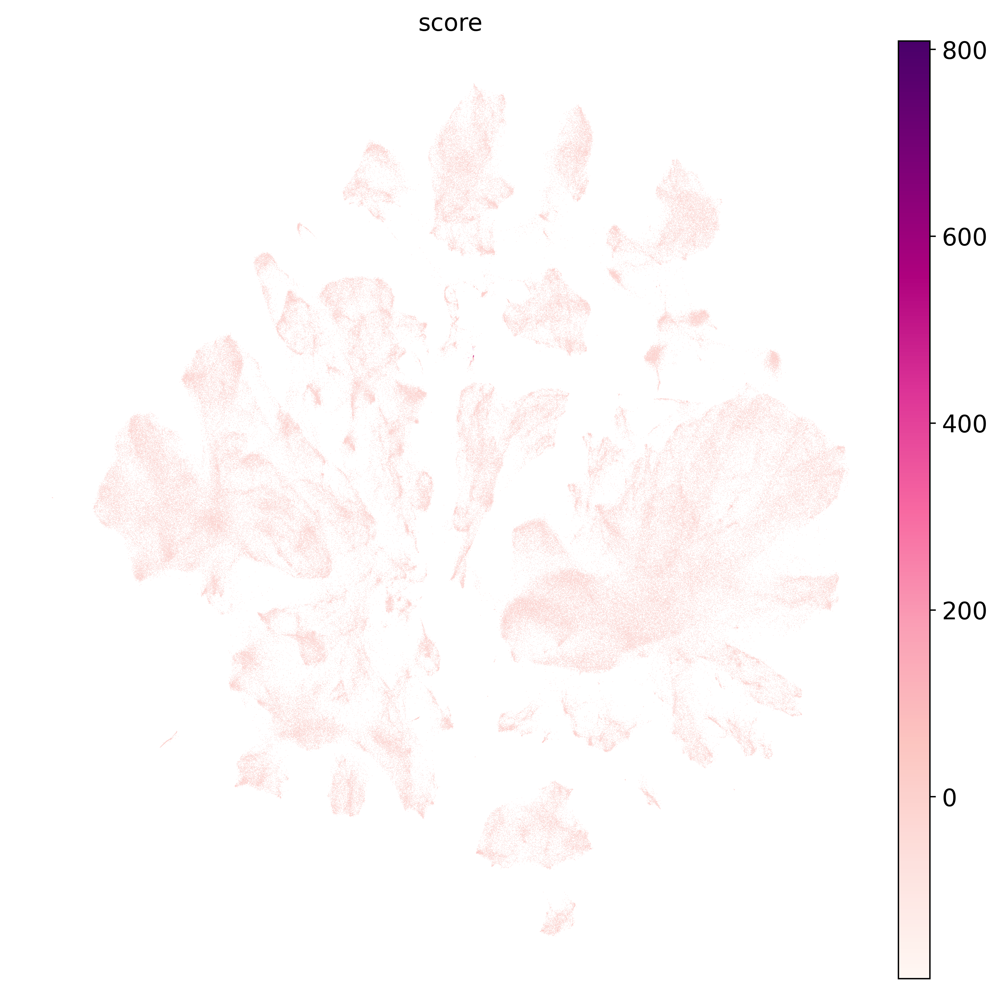

In [15]:
sc.set_figure_params(figsize=(10, 10),dpi=200)
sc.pl.umap(anndata, color= ['score'], color_map = "RdPu", size = 0.3, frameon = False)

In [64]:
# Make a separate column which has "Yes" if there is a "Stem cell" in the "Integrated_05" column
anndata.obs['Stem cell'] = anndata.obs['Integrated_05'].str.contains('Stem cell')

In [65]:
anndata.obs['Stem cell'] = anndata.obs['Stem cell'].astype('category')

/home/icb/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


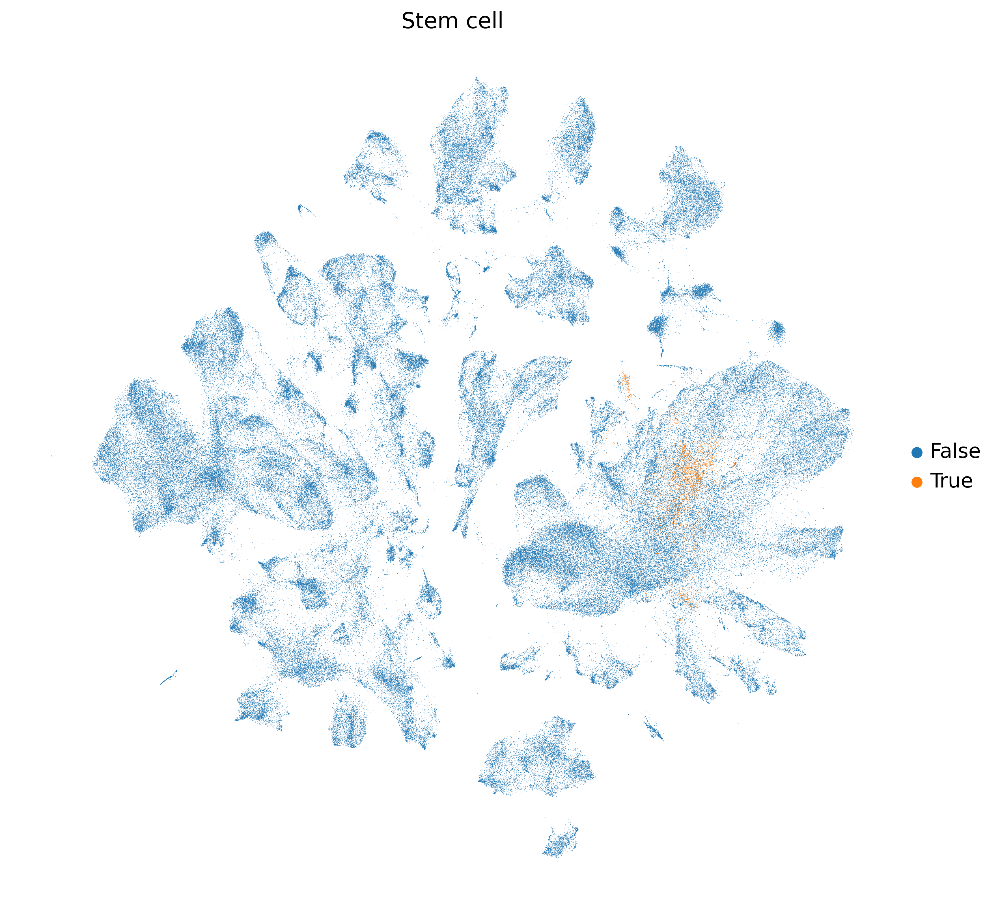

In [66]:
sc.set_figure_params(figsize=(10, 10),dpi=200)
sc.pl.umap(anndata, color= ['Stem cell'], size = 0.3, frameon = False)

In [63]:
anndata.obs

,Sample name,Diagnosis,Age,sample name,Region code,Fraction,Gender,Region,10X,batch,...,predicted_doublets,category,Age_group,Integrated_05,total_counts_ribo,pct_counts_ribo,_scvi_batch,_scvi_labels,score,Stem cell
AAACCTGAGAACAACT-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,B cells,Pediatric,DZ GC cell,491.0,24.623873,101,0,-0.20,False
AAACCTGAGCGATATA-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,B cells,Pediatric,Cycling B cell,1048.0,46.974449,101,0,-0.18,False
AAACCTGAGGAGTTTA-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,T cells,Pediatric,gdT,652.0,37.066517,101,0,-0.10,False
AAACCTGAGTATCTCG-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,B cells,Pediatric,Memory B,996.0,44.404812,101,0,-0.08,False
AAACCTGAGTGACTCT-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,B cells,Pediatric,DZ GC cell,1121.0,34.460495,101,0,-0.30,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCTCATGCATG-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,...,False,Epithelial,Adult,Colonocyte,816.0,24.220839,4,0,-0.36,False
TTTGGTTTCAACACGT-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,...,False,Mesenchymal,Adult,Stromal 1 (CCL11+),1170.0,23.669836,4,0,-0.60,False
TTTGGTTTCCAAATGC-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,...,False,Mesenchymal,Adult,Stromal 1 (CCL11+),1454.0,26.698494,4,0,-0.56,False
TTTGTCAGTGAAAGAG-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,...,False,Epithelial,Adult,Stem cells,4846.0,43.847267,4,0,0.30,True


In [72]:
stem = anndata[anndata.obs['Stem cell'].isin([True]),:]

In [73]:
stem.obs

,Sample name,Diagnosis,Age,sample name,Region code,Fraction,Gender,Region,10X,batch,...,predicted_doublets,category,Age_group,Integrated_05,total_counts_ribo,pct_counts_ribo,_scvi_batch,_scvi_labels,score,Stem cell
ACGCCAGCAGCCAATT-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,Epithelial,Pediatric,Stem cells,3160.0,36.718567,101,0,-0.48,True
ACGCCGAGTTCCCGAG-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,Epithelial,Pediatric,Stem cells,4701.0,31.944824,101,0,-1.32,True
GAACCTAAGGACAGCT-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,Epithelial,Pediatric,Stem cells,1443.0,39.534248,101,0,1.66,True
GCGCCAACACCACGTG-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,Epithelial,Pediatric,Stem cells,891.0,16.062737,101,0,1.64,True
GGTGTTACAGTCACTA-1-4918STDY7333456,T036,Pediatric healthy,4,T036-TIL-SC-EPCAMP,TIL,SC-EPCAMP,M,SmallInt,3',4918STDY7333456,...,False,Epithelial,Pediatric,Stem cells,6752.0,33.346504,101,0,0.66,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GACTACATCGGCCGAT-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,...,False,Epithelial,Adult,Stem cells,4531.0,28.547127,4,0,-0.94,True
GATCGATAGATATGGT-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,...,False,Epithelial,Adult,Stem cells,3332.0,33.951496,4,0,-0.98,True
TGGGCGTAGCTAGTGG-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,...,False,Epithelial,Adult,Stem cells,4341.0,37.636555,4,0,1.28,True
TTGAACGGTGACAAAT-1-WTDAtest7770719,A30 (398B),Healthy adult,20-25,A30-SCL-6-SC-45N-2,SCL,SC-45N,F,LargeInt,3',WTDAtest7770719,...,False,Epithelial,Adult,Stem cells,2532.0,25.119049,4,0,-0.40,True


In [74]:
# Normalize the data with log1p
sc.pp.log1p(stem)

/home/icb/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:373: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [76]:
sc.tl.rank_genes_groups(anndata, 'Integrated_05', method='wilcoxon')

ranking genes


/home/icb/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/icb/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/icb/anna.maguza/miniconda3/envs/scvi_env/lib/python3.9/site-packages/scanpy/tools/_

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:12:05)


In [77]:
top_genes = pd.DataFrame(anndata.uns['rank_genes_groups']['names']).head(100)

In [78]:
result = anndata.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})

In [79]:
wilcox_clusters.to_csv('/lustre/groups/talaveralopez/workspace/anna.maguza/Processed_datasets/top100_genes_wilcox_clusters.csv', index = False, sep = ',')